# Import Libraries

In [4]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import missingno as msno

from sklearn.preprocessing import PowerTransformer

from scipy.stats import probplot

from ydata_profiling import ProfileReport

from typing import Dict, Optional

from ml.utils.utils import (
    get_data,
    export_data,
    remove_outliers,
    numerical_categorical_analysis,
    anova_test,
    test_for_normality,
    numerical_analysis,
    two_sample_independent_ttest,
    categorical_analysis,
    multivariate_analysis
)

%matplotlib inline

In [3]:
# Set the maximum number of columns to display
pd.set_option('display.max_columns', None) 

# Read the Data

In [4]:
df = get_data("smartphone_cleaned_v2", "processed")
analysis_df = remove_outliers(df)
analysis_df.head()

,model,price,rating,os,brand_name,has_5g,has_nfc,has_ir_blaster,num_cores,processor_speed,processor_brand,ram_capacity,internal_memory,battery_capacity,fast_charging,screen_size,resolution,refresh_rate,num_rear_cameras,num_front_cameras,primary_camera_rear,primary_camera_front,fast_charging_available,extended_memory_available,extended_upto
0,OnePlus 11 5G,54999,89.0,android,oneplus,True,True,False,8.0,3.2,snapdragon,12.0,256.0,5000.0,100.0,6.70,1440 x 3216,120,3,1,50,16.0,1,0,0.0
1,OnePlus Nord CE 2 Lite 5G,19989,81.0,android,oneplus,True,False,False,8.0,2.2,snapdragon,6.0,128.0,5000.0,33.0,6.59,1080 x 2412,120,3,1,64,16.0,1,1,1024.0
2,Samsung Galaxy A14 5G,16499,75.0,android,samsung,True,False,False,8.0,2.4,exynos,4.0,64.0,5000.0,15.0,6.60,1080 x 2408,90,3,1,50,13.0,1,1,1024.0
3,Motorola Moto G62 5G,14999,81.0,android,motorola,True,False,False,8.0,2.2,snapdragon,6.0,128.0,5000.0,NaN,6.55,1080 x 2400,120,3,1,50,16.0,1,1,1024.0
4,Realme 10 Pro Plus,24999,82.0,android,realme,True,False,False,8.0,2.6,dimensity,6.0,128.0,5000.0,67.0,6.70,1080 x 2412,120,3,1,108,16.0,1,0,0.0


In [5]:
analysis_df.shape

(942, 25)

In [96]:
# check for missing values in the data

analysis_df.isnull().sum()

model                          0
price                          0
rating                        85
os                             8
brand_name                     0
has_5g                         0
has_nfc                        0
has_ir_blaster                 0
num_cores                      5
processor_speed               41
processor_brand               20
ram_capacity                   0
internal_memory                0
battery_capacity               0
fast_charging                195
screen_size                    0
resolution                     0
refresh_rate                   0
num_rear_cameras               0
num_front_cameras              0
primary_camera_rear            0
primary_camera_front           1
fast_charging_available        0
extended_memory_available      0
extended_upto                116
dtype: int64

In [97]:
# data types of features

analysis_df.dtypes

model                         object
price                          int64
rating                       float64
os                            object
brand_name                    object
has_5g                          bool
has_nfc                         bool
has_ir_blaster                  bool
num_cores                    float64
processor_speed              float64
processor_brand               object
ram_capacity                 float64
internal_memory              float64
battery_capacity             float64
fast_charging                float64
screen_size                  float64
resolution                    object
refresh_rate                   int64
num_rear_cameras               int64
num_front_cameras             object
primary_camera_rear           object
primary_camera_front         float64
fast_charging_available        int64
extended_memory_available      int64
extended_upto                float64
dtype: object

In [98]:
analysis_df = analysis_df.assign(
    fast_charging_available = analysis_df.fast_charging_available.astype(bool)
)

In [8]:
analysis_df.fast_charging_available.dtype

dtype('bool')

In [9]:
cat_cols = analysis_df.select_dtypes(include=['object', 'bool']).columns.tolist()
cat_cols = [col for col in cat_cols if col != 'model']

num_cols = [col for col in analysis_df.columns.tolist() if col not in cat_cols and col not in ["rating", "model"]]


In [10]:
num_cols

['price',
 'num_cores',
 'processor_speed',
 'ram_capacity',
 'internal_memory',
 'battery_capacity',
 'fast_charging',
 'screen_size',
 'refresh_rate',
 'num_rear_cameras',
 'primary_camera_front',
 'extended_memory_available',
 'extended_upto']

In [11]:
cat_cols

['os',
 'brand_name',
 'has_5g',
 'has_nfc',
 'has_ir_blaster',
 'processor_brand',
 'resolution',
 'num_front_cameras',
 'primary_camera_rear',
 'fast_charging_available']

# Missing Value Analysis

## rating

In [12]:
msno.matrix(analysis_df)

<Axes: >

In [13]:
msno.heatmap(analysis_df)

<Axes: >

In [14]:
msno.dendrogram(analysis_df)

<Axes: >

In [15]:
(
    analysis_df[analysis_df
    .rating
    .isna()]
    # .brand_name
    # .unique()
    # .sort_values(by = "price")
)

,brand_name,model,price,rating,has_5g,has_nfc,has_ir_blaster,processor_brand,num_cores,processor_speed,battery_capacity,fast_charging_available,fast_charging,ram_capacity,internal_memory,screen_size,refresh_rate,resolution,num_rear_cameras,num_front_cameras,os,primary_camera_rear,primary_camera_front,extended_memory_available,extended_upto
14,samsung,Samsung Galaxy S23 Ultra 5G,114990,NaN,True,True,False,snapdragon,8.0,3.20,5000.0,True,45.0,8.0,256.0,6.80,120,1440 x 3088,4,1.0,android,200.0,12.0,0,0.0
29,oneplus,OnePlus 11 Pro,69999,NaN,True,True,False,snapdragon,8.0,3.20,4500.0,True,100.0,8.0,128.0,6.70,120,1440 x 3216,3,1.0,android,50.0,16.0,0,0.0
37,samsung,Samsung Galaxy S22 Ultra 5G,91999,NaN,True,True,False,snapdragon,8.0,3.00,5000.0,True,45.0,12.0,256.0,6.80,120,1440 x 3080,4,1.0,android,108.0,40.0,0,0.0
49,samsung,Samsung Galaxy A74 5G,42999,NaN,True,True,False,snapdragon,8.0,2.36,5000.0,True,33.0,8.0,128.0,6.70,120,1080 x 2412,4,1.0,android,108.0,32.0,1,1024.0
69,oppo,Oppo Find N Fold,99990,NaN,True,True,False,snapdragon,8.0,3.20,5000.0,True,67.0,8.0,256.0,7.10,120,1792 x 1920,2,NaN,other,50.0,NaN,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
954,huawei,Huawei Mate X,169000,NaN,True,True,True,kirin,8.0,2.86,4500.0,True,55.0,8.0,512.0,8.00,60,2200 x 2480,4,NaN,NaN,48.0,NaN,0,0.0
957,vivo,Vivo Y55S,13490,NaN,False,False,False,snapdragon,4.0,1.20,2730.0,False,NaN,3.0,16.0,5.20,60,720 x 1280,1,1.0,android,13.0,5.0,1,NaN
963,lava,Lava X3,6999,NaN,False,False,False,helio,4.0,2.00,4000.0,False,NaN,3.0,32.0,6.50,60,1600 x 720,2,1.0,android,8.0,5.0,1,512.0
972,itel,itel A23s,4787,NaN,False,False,False,spreadtrum,4.0,1.40,3020.0,False,NaN,2.0,32.0,5.00,60,854 x 480,1,NaN,android,2.0,NaN,0,0.0


In [16]:
(
    analysis_df
    # .rating
    .dropna(subset = ["rating"])
    # .shape
    .isnull().sum()
    .loc[lambda x: x > 0]
    # .index
    # .to_list()
)

processor_brand          17
num_cores                 6
processor_speed          39
battery_capacity         10
fast_charging           173
os                        9
primary_camera_front      1
extended_upto           106
dtype: int64

## processor_brand

In [29]:
(
    handle_missing(analysis_df)
    [handle_missing(analysis_df).processor_brand.isnull()]
    .brand_name
    .unique()
    # .to_list()
    # .value_counts()
    # .isnull()
    # .shape
)

array([], dtype=object)

In [ ]:
missing_analysis= analysis_df.groupby('brand_name')['processor_brand'].apply(lambda x: x.isnull().mean())[['tesla', 'ikall', 'samsung', 'tecno', 'huawei']]
print("Missingness ratio by brand_name:")
print(missing_analysis)

## num_cores

In [ ]:
(
    handle_missing(analysis_df)
    # [handle_missing(analysis_df).num_cores.isna()]
    .dropna(subset=['num_cores'])
    .shape
)

In [ ]:
(6/875) * 100

## processor_speed

In [ ]:
(
    handle_missing(analysis_df)
    [handle_missing(analysis_df).processor_speed.isna()]
    # .shape
)

In [ ]:
export_data(
    dataframe = handle_missing(analysis_df)
    [handle_missing(analysis_df).processor_speed.isna()],
    name = "mv_processor_speed"
)

In [ ]:
(33 / 875) * 100

## os

In [104]:
analysis_df.query("brand_name == 'royole'")

,brand_name,model,price,rating,has_5g,has_nfc,has_ir_blaster,processor_brand,num_cores,processor_speed,battery_capacity,fast_charging_available,fast_charging,ram_capacity,internal_memory,screen_size,refresh_rate,resolution,num_rear_cameras,num_front_cameras,os,primary_camera_rear,primary_camera_front,extended_memory_available,extended_upto
320,royole,Royole FlexPai 2,109999,87.0,True,False,False,snapdragon,8.0,2.84,4450.0,False,NaN,8.0,128.0,7.8,60,1440 x 1920,3,1.0,NaN,64.0,32.0,0,0.0
861,royole,Royole FlexPai 3 5G,149999,87.0,True,False,False,snapdragon,8.0,2.84,3360.0,False,NaN,8.0,128.0,7.2,60,1440 x 1920,3,1.0,NaN,64.0,32.0,0,0.0


In [106]:
(
    handle_missing(analysis_df)
    [handle_missing(analysis_df).os.isna()]
    .brand_name.unique()
    # .shape
)

array(['samsung', 'royole', 'oppo', 'lg', 'huawei'], dtype=object)

## battery_capacity

In [ ]:
(

    handle_missing(analysis_df)
    [ handle_missing(analysis_df)
    .battery_capacity
    .isna()]
    
)

## fast_charging

In [28]:
(
    handle_missing(analysis_df)
    [ handle_missing(analysis_df)
    .fast_charging
    .isna()]
    .query("fast_charging_available == 1")
    # .brand_name
    # .value_counts() / 
    # (
    #     handle_missing(analysis_df)
    #     [ handle_missing(analysis_df)
    #     .fast_charging
    #     .isna()]
    #     .query("fast_charging_available == 1")
    #     .brand_name
    #     .shape
    # )
    
   
)

,brand_name,model,price,rating,has_5g,has_nfc,has_ir_blaster,processor_brand,num_cores,processor_speed,battery_capacity,fast_charging_available,fast_charging,ram_capacity,internal_memory,screen_size,refresh_rate,resolution,num_rear_cameras,num_front_cameras,os,primary_camera_rear,primary_camera_front,extended_memory_available,extended_upto


In [ ]:
pd.merge(
    left = (
        handle_missing(analysis_df)
        [ handle_missing(analysis_df)
        .fast_charging
        .isna()]
        .groupby(by = "brand_name")["price"].mean()
    ),
    right = (
        handle_missing(analysis_df)
        [ handle_missing(analysis_df)
        .fast_charging
        .notna()]
        .groupby(by = "brand_name")["price"].mean()
    ),
    on = "brand_name",
    suffixes=('_missing', '_not_missing')
    
)


In [ ]:
(
    handle_missing(analysis_df)
    [ handle_missing(analysis_df)
    .fast_charging
    .notna()]
    .groupby(by = "brand_name")["price"].mean()
)


In [ ]:
export_data(
    dataframe = handle_missing(analysis_df)
    [handle_missing(analysis_df).fast_charging.isna()],
    name = "mv_fast_charging"
)

In [ ]:
151/ 836

In [ ]:
analysis_df.fast_charging.dtype

In [ ]:
numerical_analysis(dataframe = analysis_df, column_name = "fast_charging", bins = 10)

## primary_camera_front

In [ ]:
(
    handle_missing(analysis_df)
    [ handle_missing(analysis_df)
    .primary_camera_front
    .isna()]
   
)

## extended_upto

In [ ]:
(
    handle_missing(analysis_df)
    # [ handle_missing(analysis_df)
    # .extended_upto
    # .isna()]
    .shape
   
)

In [ ]:
export_data(
    dataframe = handle_missing(analysis_df)
    [handle_missing(analysis_df).extended_upto.isna()],
    name = "mv_extended_upto"
)

In [ ]:
104/836

### Observations - Missing Value Analysis 

- The rating column seems to have missing value MCAR there are phones of various prices and brands.As it is target column so better remove them.
- Only one missing value in primary_camera_front which is MCAR so we can drop it.
- Missing values in processor_brand were handled by imputing the most frequent value within each brand_name where partial data existed (e.g., Samsung, Huawei) and assigning Unknown to brands with entirely missing data (e.g., iKall, Tesla).
- The columns num_cores and processor_speed were missing for 6 rows (~0.69% of the dataset), predominantly for specific brands (Apple and Nokia). Since the missing data was determined to be MAR (Missing at Random) and constituted a negligible portion of the dataset, these rows were dropped.
- The processor_brand column had 33 missing values (~3.77%), determined to be MCAR. These rows were dropped.
- Missing battery_capacity values for Apple devices were imputed using the median value for Apple.
- Missing values in extended_upto are only present for phones with extended_memory_available = 1. These values were imputed using the global median of extended_upto.
- Missing Fast Charging Capacity Analysis:
 
`Consistent Values:` LG, OnePlus, Xiaomi, and Vivo show similar values, suitable for uniform imputation.

`Higher Missing Percentage:` Samsung (17%) and Apple (36%) need brand-specific median imputation.

`Lower Missing Percentage:` Sony, Xiaomi, Oppo, Motorola, and Google (2-8%) should use median imputation.

`Minimal Impact:` Blu, Leitz, and Sharp have one missing value each and can be removed.

## Missing Value Operations

In [5]:
def calculate_brand_mode(df: pd.DataFrame) -> Dict[str, str]:
    """
    Computes the most frequently occurring processor brand for each 'brand_name' 
    in the dataset.

    This function filters out rows where 'processor_brand' is null, then groups 
    by 'brand_name' and calculates the mode (most common value) for 'processor_brand'. 
    If multiple modes exist, the first one is selected. If no mode exists, 'Unknown' 
    is assigned.

    :param df: The input DataFrame containing 'brand_name' and 'processor_brand' columns.
    :type df: pd.DataFrame
    :return: A dictionary where keys are unique brand names and values are the most common 
             processor brand for each brand.
    :rtype: Dict[str, str]
    """
    return (
        df[df['processor_brand'].notnull()]
        .groupby('brand_name')['processor_brand']
        .agg(lambda x: x.mode()[0] if not x.mode().empty else 'Unknown')
        .to_dict()
    )

In [6]:
def impute_missing_processor_brand(df: pd.DataFrame, brand_processor_mode: Dict[str, str]) -> pd.DataFrame:
    """
    Imputes missing values in the 'processor_brand' column based on the most common 
    processor brand for each 'brand_name'. If a brand is not found in the mapping, 
    it assigns 'Unknown'. Additionally, for specific brands like 'ikall' and 'tesla', 
    it directly assigns 'Unknown'.

    :param df: The input DataFrame containing 'brand_name' and 'processor_brand' columns.
    :type df: pd.DataFrame
    :param brand_processor_mode: A dictionary mapping brand names to their most common processor brand.
    :type brand_processor_mode: Dict[str, str]
    :return: A DataFrame with missing 'processor_brand' values imputed.
    :rtype: pd.DataFrame
    """
    def impute_processor(row: pd.Series) -> str:  # Type hint for inner function
        if row['brand_name'] in ['ikall', 'tesla']:
            return 'Unknown'
        elif pd.isnull(row['processor_brand']):
            return brand_processor_mode.get(row['brand_name'], 'Unknown')
        return row['processor_brand']

    df['processor_brand'] = df.apply(impute_processor, axis=1)
    return df

In [7]:
def impute_consistent_brands(df: pd.DataFrame) -> pd.DataFrame:
    """
    Imputes missing values in the 'fast_charging' column for specific consistent brands 
    ('lg', 'oneplus', 'xiaomi', 'vivo') using the median value of 'fast_charging' for each brand.

    :param df: The input DataFrame containing 'brand_name' and 'fast_charging' columns.
    :type df: pd.DataFrame
    :return: The modified DataFrame with imputed values for 'fast_charging' in the specified brands.
    :rtype: pd.DataFrame
    """
    consistent_brands: List[str] = ['lg', 'oneplus', 'xiaomi', 'vivo']  # Type hint for clarity
    for brand in consistent_brands:
        median_value = df.loc[df['brand_name'].str.lower() == brand, 'fast_charging'].median()
        df.loc[
            (df['brand_name'].str.lower() == brand) & (df['fast_charging'].isnull()),
            'fast_charging'
        ] = median_value
    return df

In [8]:
def impute_higher_missing_brands(df: pd.DataFrame) -> pd.DataFrame:
    """
    Imputes missing values in the 'fast_charging' column for brands with a higher number 
    of missing values, specifically 'samsung' and 'apple'. The imputation is done using 
    the median 'fast_charging' value for each respective brand.

    :param df: The input DataFrame containing 'brand_name' and 'fast_charging' columns.
    :type df: pd.DataFrame
    :return: A DataFrame with missing 'fast_charging' values imputed for specified brands.
    :rtype: pd.DataFrame
    """
    higher_missing_brands: List[str] = ['samsung', 'apple']  # Type hint for clarity
    for brand in higher_missing_brands:
        median_value = df.loc[df['brand_name'].str.lower() == brand, 'fast_charging'].median()
        df.loc[
            (df['brand_name'].str.lower() == brand) & (df['fast_charging'].isnull()),
            'fast_charging'
        ] = median_value
    return df

In [10]:
def impute_lower_missing_brands(df):
    """
    Imputes missing values in the 'fast_charging' column for brands with a lower number 
    of missing values, specifically 'sony', 'xiaomi', 'oppo', 'motorola', and 'google'. 
    The imputation is done using the median 'fast_charging' value for each respective brand.

    Parameters:
    df (pd.DataFrame): The input DataFrame containing 'brand_name' and 'fast_charging' columns.

    Returns:
    pd.DataFrame: A DataFrame with missing 'fast_charging' values imputed for specified brands.
    """
    lower_missing_brands = ['sony', 'xiaomi', 'oppo', 'motorola', 'google']
    for brand in lower_missing_brands:
        median_value = df.loc[df['brand_name'].str.lower() == brand, 'fast_charging'].median()
        df.loc[
            (df['brand_name'].str.lower() == brand) & (df['fast_charging'].isnull()), 
            'fast_charging'
        ] = median_value
    return df


In [9]:
def remove_single_record_brands(df: pd.DataFrame) -> pd.DataFrame:
    """
    Removes rows where the 'brand_name' belongs to a predefined list of brands 
    that have only a single record in the dataset. This helps in ensuring 
    consistency and avoiding potential issues with statistical analysis.

    :param df: The input DataFrame containing a 'brand_name' column.
    :type df: pd.DataFrame
    :return: A DataFrame with rows corresponding to single-record brands removed.
    :rtype: pd.DataFrame
    """
    single_record_brands: List[str] = ['blu', 'leitz', 'sharp']  # Type hint for clarity
    return df[~df['brand_name'].str.lower().isin(single_record_brands)]

In [10]:
def impute_os_by_brand(df: pd.DataFrame) -> pd.DataFrame:
    """
    Imputes missing values in the 'os' column based on the most common 
    operating system (mode) for each brand.

    :param df: The input DataFrame containing 'brand_name' and 'os' columns.
    :type df: pd.DataFrame
    :return: A DataFrame with missing 'os' values imputed using the mode 
             of each corresponding 'brand_name'.
    :rtype: pd.DataFrame
    """
    os_mode: Dict[str, Optional[str]] = df.groupby('brand_name')['os'].agg(lambda x: x.mode()[0] if not x.mode().empty else None).to_dict()

    # Impute missing OS values based on the brand's mode
    df['os'] = df.apply(
        lambda row: os_mode.get(row['brand_name']) if pd.isnull(row['os']) else row['os'], axis=1
    )

    return df

In [11]:
def handle_missing(df: pd.DataFrame) -> pd.DataFrame:
    """
    Handles missing values in the dataset by applying a series of preprocessing steps.

    Steps included:
    1. Drops rows with missing 'rating' and 'primary_camera_front'.
    2. Imputes missing 'processor_brand' based on the most common value for each brand.
    3. Drops rows with missing 'num_cores' and 'processor_speed'.
    4. Imputes missing 'battery_capacity' for Apple devices using the median.
    5. Imputes 'extended_upto' for devices with extended memory available using the median.
    6. Sets 'fast_charging' to 0 if 'fast_charging_available' is 0 and the value is missing.
    7. Applies imputation functions for consistent brands, higher missing brands, and lower missing brands.
    8. Removes brands with single records.
    9. Imputes missing 'os' values based on the brand mode.
    10. Drops any remaining missing values in the 'os' column.

    :param df: Input DataFrame containing mobile phone data.
    :type df: pd.DataFrame
    :return: A cleaned DataFrame with missing values handled.
    :rtype: pd.DataFrame
    """

    def _impute_battery_extended(df_: pd.DataFrame) -> pd.DataFrame:
        apple_median = df_.loc[df_['brand_name'].str.lower() == 'apple', 'battery_capacity'].median()
        extended_memory_median = df_.loc[df_['extended_memory_available'] == 1, 'extended_upto'].median()
        return df_.assign(
            battery_capacity=df_['battery_capacity'].fillna(apple_median),
            extended_upto=df_.apply(
                lambda row: row['extended_upto'] if pd.notnull(row['extended_upto'])
                else extended_memory_median,
                axis=1
            ),
            fast_charging=df_.apply(
                lambda row: 0 if row['fast_charging_available'] == 0 and pd.isnull(row['fast_charging'])
                else row['fast_charging'],
                axis=1
            )
        )

    return (
        df
        .dropna(subset=["rating"])
        .dropna(subset=["primary_camera_front"])
        .pipe(impute_missing_processor_brand, calculate_brand_mode(df)) 
        .dropna(subset=['num_cores'])
        .dropna(subset=['processor_speed'])
        .pipe(_impute_battery_extended) 
        .pipe(impute_consistent_brands)
        .pipe(impute_higher_missing_brands)
        .pipe(impute_lower_missing_brands) 
        .pipe(remove_single_record_brands)
        .pipe(impute_os_by_brand)
        .dropna(subset=["os"])
    )


In [14]:
final_df = (
    handle_missing(analysis_df)
)

In [15]:
final_df.shape

(816, 25)

In [16]:
final_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 816 entries, 0 to 978
Data columns (total 25 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   model                      816 non-null    object 
 1   price                      816 non-null    int64  
 2   rating                     816 non-null    float64
 3   os                         816 non-null    object 
 4   brand_name                 816 non-null    object 
 5   has_5g                     816 non-null    bool   
 6   has_nfc                    816 non-null    bool   
 7   has_ir_blaster             816 non-null    bool   
 8   num_cores                  816 non-null    float64
 9   processor_speed            816 non-null    float64
 10  processor_brand            816 non-null    object 
 11  ram_capacity               816 non-null    float64
 12  internal_memory            816 non-null    float64
 13  battery_capacity           816 non-null    float64
 14 

In [17]:
final_df.columns

Index(['model', 'price', 'rating', 'os', 'brand_name', 'has_5g', 'has_nfc',
       'has_ir_blaster', 'num_cores', 'processor_speed', 'processor_brand',
       'ram_capacity', 'internal_memory', 'battery_capacity', 'fast_charging',
       'screen_size', 'resolution', 'refresh_rate', 'num_rear_cameras',
       'num_front_cameras', 'primary_camera_rear', 'primary_camera_front',
       'fast_charging_available', 'extended_memory_available',
       'extended_upto'],
      dtype='object')

# Descriptive Statistics

In [109]:
final_df.describe()

,price,rating,num_cores,processor_speed,ram_capacity,internal_memory,battery_capacity,fast_charging,screen_size,refresh_rate,num_rear_cameras,primary_camera_front,extended_memory_available,extended_upto
count,816.000000,816.000000,816.000000,816.000000,816.000000,816.000000,816.000000,816.000000,816.000000,816.000000,816.000000,816.000000,816.000000,816.000000
mean,25011.768382,78.399510,7.899510,2.408493,6.427696,130.823529,4835.439951,37.927083,6.547120,92.246324,2.838235,16.289093,0.672794,533.647059
std,19713.554565,7.380771,0.537844,0.419999,2.438881,81.075641,577.003139,34.213313,0.198718,27.938791,0.726912,10.194601,0.469481,465.741720
min,3499.000000,60.000000,4.000000,1.300000,2.000000,32.000000,1821.000000,0.000000,4.700000,60.000000,1.000000,5.000000,0.000000,0.000000
25%,12999.000000,74.000000,8.000000,2.050000,4.000000,64.000000,4500.000000,18.000000,6.500000,60.000000,2.000000,8.000000,0.000000,0.000000
50%,18844.500000,80.000000,8.000000,2.300000,6.000000,128.000000,5000.000000,30.000000,6.565000,90.000000,3.000000,16.000000,1.000000,512.000000
75%,29990.000000,84.000000,8.000000,2.730000,8.000000,128.000000,5000.000000,65.000000,6.670000,120.000000,3.000000,16.000000,1.000000,1024.000000
max,179900.000000,89.000000,8.000000,3.220000,18.000000,1024.000000,7000.000000,240.000000,6.950000,165.000000,4.000000,60.000000,1.000000,2048.000000


# Univariate Ananlysis

## Numerical columns

In [13]:
num_cols

['price',
 'num_cores',
 'processor_speed',
 'ram_capacity',
 'internal_memory',
 'battery_capacity',
 'fast_charging',
 'screen_size',
 'refresh_rate',
 'num_rear_cameras',
 'primary_camera_front',
 'fast_charging_available',
 'extended_memory_available',
 'extended_upto']

## rating

In [14]:
numerical_analysis(final_df, "rating", bins=10)

In [15]:
# plot QQ plot for the price

probplot(final_df["rating"], plot = plt)
plt.show()

In [16]:
test_for_normality(dataframe = final_df, column_name = "rating")

Jarque Bera Test for Normality
nan
Fail to reject the null hypothesis. The data is normally distributed.


In [17]:
final_df.rating.skew()

np.float64(-0.7004333633011043)

In [18]:
pt = PowerTransformer(method='yeo-johnson')
final_df.assign(rating_pt = lambda df: pt.fit_transform(final_df[["rating"]])).rating_pt

0      1.805849
1      0.261963
2     -0.601894
3      0.261963
4      0.428757
         ...   
975    0.602608
976   -0.601894
977    0.972317
978    0.102018
979   -0.724853
Name: rating_pt, Length: 942, dtype: float64

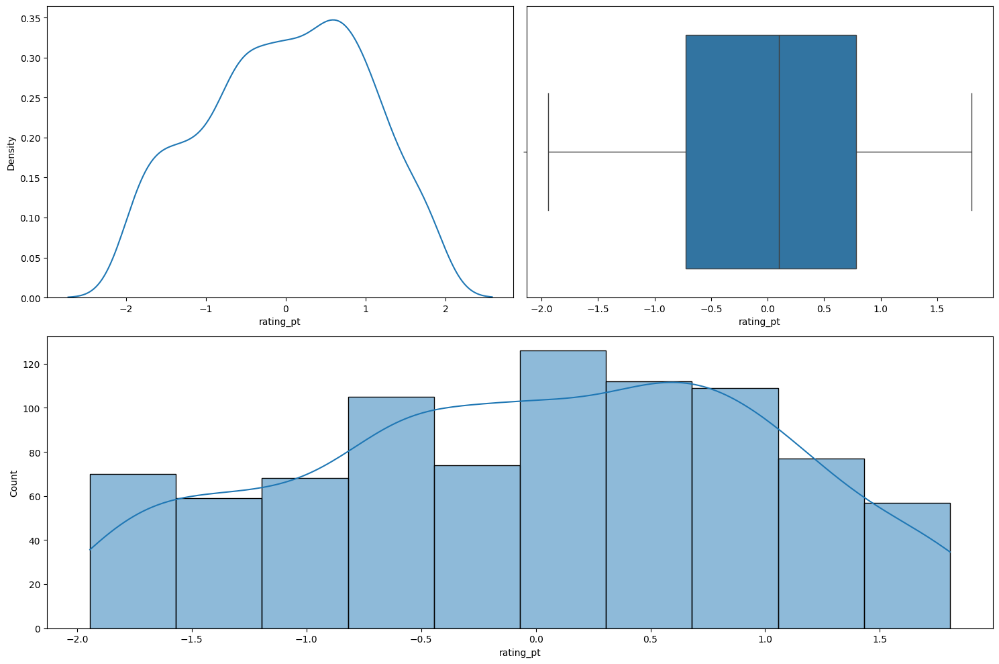

In [19]:
final_df.assign(rating_pt = lambda df: pt.fit_transform(final_df[["rating"]]))

numerical_analysis(final_df.assign(rating_pt = lambda df: pt.fit_transform(final_df[["rating"]])), "rating_pt", bins=10)

In [20]:
test_for_normality(dataframe = final_df.assign(rating_pt = lambda df: pt.fit_transform(final_df[["rating"]])), column_name = "rating_pt")

Jarque Bera Test for Normality
nan
Fail to reject the null hypothesis. The data is normally distributed.


### Observations - rating

- Left skewed.

## price

In [21]:
numerical_analysis(final_df, "price", bins=10)

In [22]:
(
    final_df[final_df.price > 100000]
    # .shape
    # final_df[(final_df['price'] > 50000) & (final_df['price'] <= 100000)]
)

,model,price,rating,os,brand_name,has_5g,has_nfc,has_ir_blaster,num_cores,processor_speed,processor_brand,ram_capacity,internal_memory,battery_capacity,fast_charging,screen_size,resolution,refresh_rate,num_rear_cameras,num_front_cameras,primary_camera_rear,primary_camera_front,fast_charging_available,extended_memory_available,extended_upto
14,Samsung Galaxy S23 Ultra 5G,114990,NaN,android,samsung,True,True,False,8.0,3.20,snapdragon,8.0,256.0,5000.0,45.0,6.80,1440 x 3088,120,4,1,200,12.0,1,0,0.0
27,Apple iPhone 14 Pro Max,129990,76.0,ios,apple,True,True,False,6.0,NaN,bionic,6.0,128.0,4323.0,NaN,6.70,1290 x 2796,120,3,1,48,12.0,1,0,0.0
76,Apple iPhone 13 Pro,119900,83.0,ios,apple,True,True,False,6.0,3.22,bionic,6.0,128.0,3095.0,NaN,6.10,1170 x 2532,120,3,1,12,12.0,1,0,0.0
100,Apple iPhone 14 Pro,119990,75.0,ios,apple,True,True,False,6.0,NaN,bionic,6.0,128.0,3200.0,NaN,6.10,1179 x 2556,120,3,1,48,12.0,1,0,0.0
152,Apple iPhone 15 Pro Max,142990,79.0,ios,apple,True,True,False,NaN,NaN,bionic,8.0,256.0,4352.0,25.0,6.68,1284 x 2778,120,3,1,50,12.0,1,0,0.0
161,Apple iPhone 13 Pro Max,129900,84.0,ios,apple,True,True,False,6.0,3.22,bionic,6.0,128.0,4352.0,NaN,6.70,1284 x 2778,120,3,1,12,12.0,1,0,0.0
209,Apple iPhone 14 Pro Max (256GB),139990,77.0,ios,apple,True,True,False,6.0,NaN,bionic,6.0,256.0,4323.0,NaN,6.70,1290 x 2796,120,3,1,48,12.0,1,0,0.0
288,Apple iPhone 14 Pro Max (1TB),182999,78.0,ios,apple,True,True,False,6.0,NaN,bionic,6.0,1024.0,4323.0,NaN,6.70,1290 x 2796,120,3,1,48,12.0,1,0,0.0
311,Samsung Galaxy S22 Ultra 5G (12GB RAM + 512GB),118999,NaN,android,samsung,True,True,False,8.0,3.00,snapdragon,12.0,512.0,5000.0,45.0,6.80,1440 x 3080,120,4,1,108,40.0,1,0,0.0
326,Samsung Galaxy S21 Ultra,105999,NaN,android,samsung,True,True,False,8.0,2.90,exynos,12.0,256.0,5000.0,25.0,6.80,1440 x 3200,120,4,1,108,40.0,1,0,0.0


### Observations - price

- Right skewed.
- Potential outliers - It has been observed many phones above price of 100000 are foldable phones with screen size >= 7

## num_cores

In [23]:
final_df.num_cores.value_counts()

num_cores
8.0    872
4.0     36
6.0     29
Name: count, dtype: int64

In [24]:
numerical_analysis(final_df, "num_cores", bins=10)

### Observations - num_cores

- There are only three distinct values. Can be changed to categorical column(ordinal).

## processor_speed

In [25]:
numerical_analysis(final_df, "processor_speed", bins=10)

### Observations - processor_speed

- Bimodal distribution

## battery_capacity

In [26]:
final_df.battery_capacity.describe()

count     942.000000
mean     4784.175159
std       636.735040
min      1821.000000
25%      4500.000000
50%      5000.000000
75%      5000.000000
max      7000.000000
Name: battery_capacity, dtype: float64

In [27]:
(
    final_df[final_df.battery_capacity < 2500]
    # .shape
    # final_df[(final_df['price'] > 50000) & (final_df['price'] <= 100000)]
)

,model,price,rating,os,brand_name,has_5g,has_nfc,has_ir_blaster,num_cores,processor_speed,processor_brand,ram_capacity,internal_memory,battery_capacity,fast_charging,screen_size,resolution,refresh_rate,num_rear_cameras,num_front_cameras,primary_camera_rear,primary_camera_front,fast_charging_available,extended_memory_available,extended_upto
173,Apple iPhone 9,29990,61.0,ios,apple,False,True,False,6.0,2.65,bionic,3.0,64.0,2050.0,NaN,4.70,750 x 1334,60,1,1,12,7.0,1,0,0.0
190,Duoqin F22 Pro,9990,NaN,android,duoqin,False,False,False,8.0,2.00,helio,4.0,64.0,2150.0,NaN,3.54,640 x 960,60,1,1,8,2.0,0,1,NaN
275,Apple iPhone 13 Mini,64900,79.0,ios,apple,True,True,False,6.0,3.22,bionic,4.0,128.0,2438.0,NaN,5.40,1080 x 2340,60,2,1,12,12.0,1,0,0.0
472,Vivo Y25,7499,NaN,android,vivo,False,False,False,4.0,1.30,helio,1.0,16.0,1900.0,NaN,4.50,480 x 854,60,1,1,5,2.0,0,1,128.0
595,Apple iPhone 7s,52990,NaN,ios,apple,False,False,False,4.0,2.37,fusion,3.0,32.0,2230.0,NaN,4.70,750 x 1334,60,1,1,13,7.0,0,0,0.0
638,Apple iPhone SE 2020,39900,63.0,ios,apple,False,True,False,6.0,2.65,bionic,3.0,64.0,1821.0,18.0,4.70,750 x 1334,60,1,1,12,7.0,1,0,0.0
817,CAT S22 Flip,14999,NaN,NaN,cat,False,False,False,4.0,1.30,snapdragon,2.0,16.0,2000.0,NaN,4.00,480 x 640,60,1,1,5,2.0,0,0,0.0
874,Itel A23 Pro,3999,NaN,android,itel,False,False,False,4.0,1.40,spreadtrum,1.0,8.0,2400.0,NaN,5.00,854 x 480,60,1,1,5,2.0,0,0,0.0


In [28]:
numerical_analysis(final_df, "battery_capacity", bins=10)

In [29]:
(
    numerical_analysis(final_df[~(final_df['battery_capacity'] > 7000)], "battery_capacity", bins=10)
   
)

### Observations - battery_capacity

- Potential outliers - drop them as they are in niche category. battery_capacity > 7000

## fast_charging

In [30]:
numerical_analysis(final_df, "fast_charging", bins=10)

In [31]:
final_df.fast_charging.skew()

np.float64(1.6595101758624968)

In [32]:
(
    final_df[final_df.fast_charging > 150] 
    # .shape
    
)

,model,price,rating,os,brand_name,has_5g,has_nfc,has_ir_blaster,num_cores,processor_speed,processor_brand,ram_capacity,internal_memory,battery_capacity,fast_charging,screen_size,resolution,refresh_rate,num_rear_cameras,num_front_cameras,primary_camera_rear,primary_camera_front,fast_charging_available,extended_memory_available,extended_upto
38,Xiaomi Redmi Note 12 Pro Max 5G,32999,83.0,android,xiaomi,True,False,True,8.0,2.36,snapdragon,6.0,128.0,5200.0,210.0,6.67,1080 x 2460,120,4,1,108,32.0,1,1,512.0
180,Infinix Zero Ultra,36999,89.0,android,infinix,True,False,False,8.0,2.50,dimensity,8.0,256.0,4500.0,180.0,6.80,1080 x 2400,120,3,1,200,32.0,1,1,NaN
230,iQOO 11 Pro 5G,58990,89.0,android,iqoo,True,True,True,8.0,3.20,snapdragon,8.0,256.0,4700.0,200.0,6.78,1440 x 3200,144,3,1,50,16.0,1,0,0.0
397,Realme GT Neo 5,34999,83.0,android,realme,True,True,False,8.0,3.20,snapdragon,8.0,128.0,4600.0,240.0,6.70,1080 x 2412,120,3,1,50,16.0,1,0,0.0
511,Xiaomi Redmi Note 12 Discovery Edition,26990,86.0,android,xiaomi,True,True,True,8.0,2.60,dimensity,8.0,256.0,4300.0,210.0,6.67,1080 x 2400,120,3,1,200,16.0,1,0,0.0
559,Nubia Red Magic 8 Pro Plus,60999,86.0,android,nubia,True,True,False,8.0,3.20,snapdragon,12.0,256.0,5000.0,165.0,6.80,1116 x 2480,120,3,1,50,16.0,1,0,0.0


In [33]:
test_for_normality(dataframe = final_df.assign(fast_charging_pt = lambda df: pt.fit_transform(final_df[["fast_charging"]])), column_name = "fast_charging_pt")

Jarque Bera Test for Normality
nan
Fail to reject the null hypothesis. The data is normally distributed.


,Count,Percentage
fast_charging,,
33.0,149,19.95%
18.0,128,17.14%
67.0,61,8.17%
25.0,50,6.69%
120.0,46,6.16%
15.0,43,5.76%
80.0,40,5.35%
10.0,33,4.42%
30.0,32,4.28%


**************************************************
The unique categories in fast_charging column are [100.0, 33.0, 15.0, nan, 67.0, 25.0, 120.0, 80.0, 18.0, 45.0, 10.0, 66.0, 44.0, 210.0, 30.0, 150.0, 68.0, 50.0, 20.0, 65.0, 180.0, 125.0, 40.0, 60.0, 200.0, 240.0, 19.0, 21.0, 135.0, 165.0, 22.0, 55.0]
**************************************************
The number of categories in fast_charging column are 31


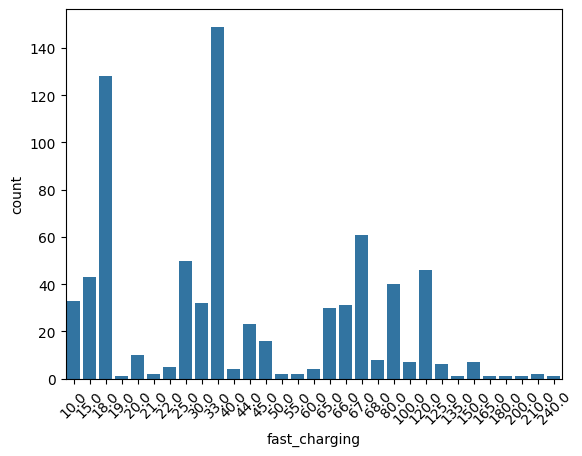

In [34]:
categorical_analysis(final_df, "fast_charging")

### Observations - fast_charging

- Right skewed but can be transformed to almost normal distribution.

## ram_capacity

In [35]:
numerical_analysis(final_df, "ram_capacity", bins=10)

,Count,Percentage
ram_capacity,,
8.0,329,34.93%
6.0,231,24.52%
4.0,209,22.19%
12.0,70,7.43%
3.0,54,5.73%
2.0,31,3.29%
16.0,9,0.96%
1.0,7,0.74%
18.0,2,0.21%


**************************************************
The unique categories in ram_capacity column are [12.0, 6.0, 4.0, 8.0, 3.0, 16.0, 2.0, 18.0, 1.0]
**************************************************
The number of categories in ram_capacity column are 9


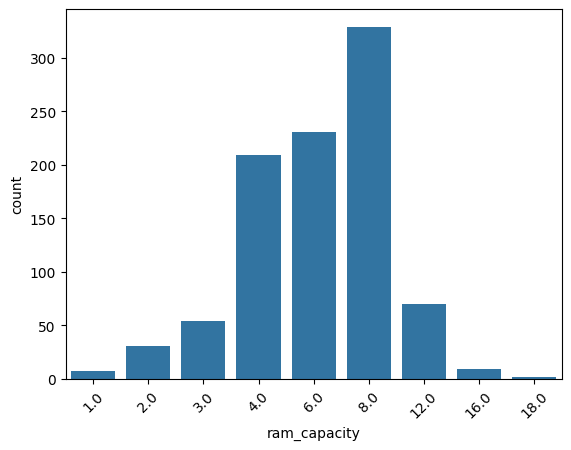

In [36]:
categorical_analysis(final_df, "ram_capacity")

### Observations - ram_capacity

- There are only eight distinct values. Can be changed to categorical column(ordinal).

## internal_memory

In [37]:
numerical_analysis(final_df, "internal_memory", bins=10)

In [39]:
internal_memory_outliers = (
    final_df[final_df.internal_memory > 200] 
    # .shape
    
)

In [67]:
export_data(internal_memory_outliers, "internal_memory_outliers")

Data successfully exported to: E:\Learnings\Learning_curves\Smartphone_spec_score_analysis\data\export\internal_memory_outliers.csv


,Count,Percentage
internal_memory,,
128.0,517,54.88%
64.0,188,19.96%
256.0,139,14.76%
32.0,67,7.11%
512.0,14,1.49%
16.0,12,1.27%
1024.0,4,0.42%
8.0,1,0.11%


**************************************************
The unique categories in internal_memory column are [256.0, 128.0, 64.0, 32.0, 512.0, 1024.0, 16.0, 8.0]
**************************************************
The number of categories in internal_memory column are 8


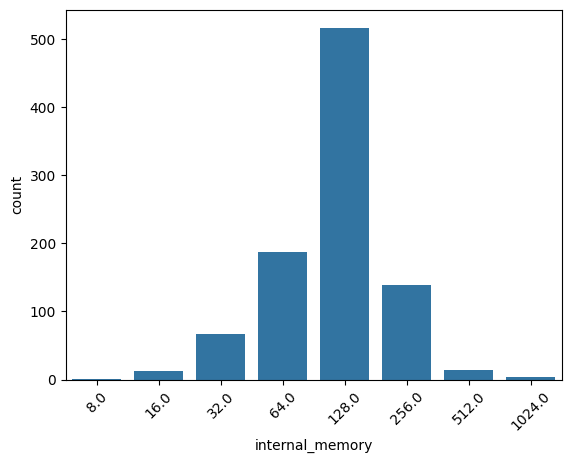

In [40]:
categorical_analysis(final_df, "internal_memory")

### Observations - internal_memory

- There are only six distinct values. Can be changed to categorical column(ordinal).

## screen_size

In [41]:
numerical_analysis(final_df, "screen_size", bins=10)

In [42]:
test_for_normality(dataframe = final_df, column_name = "screen_size")

Jarque Bera Test for Normality
0.0
Reject the null hypothesis. The data is not normally distributed.


In [43]:
screen_df = final_df[final_df.screen_size < 7]

In [44]:
(
    numerical_analysis(screen_df, "screen_size", bins=10) 
    # .shape
    
)

In [45]:
test_for_normality(dataframe = screen_df, column_name = "screen_size")

Jarque Bera Test for Normality
0.0
Reject the null hypothesis. The data is not normally distributed.


In [46]:
(
    final_df[final_df.screen_size > 7] 
    # .shape
    
)

,model,price,rating,os,brand_name,has_5g,has_nfc,has_ir_blaster,num_cores,processor_speed,processor_brand,ram_capacity,internal_memory,battery_capacity,fast_charging,screen_size,resolution,refresh_rate,num_rear_cameras,num_front_cameras,primary_camera_rear,primary_camera_front,fast_charging_available,extended_memory_available,extended_upto


In [47]:
categorical_analysis(dataframe=final_df, column_name="screen_size")

,Count,Percentage
screen_size,,
6.50,119,12.63%
6.67,97,10.3%
6.70,93,9.87%
6.60,91,9.66%
6.40,43,4.56%
...,...,...
5.84,1,0.11%
6.34,1,0.11%
6.09,1,0.11%


**************************************************
The unique categories in screen_size column are [6.7, 6.59, 6.6, 6.55, 6.1, 6.67, 6.43, 6.72, 6.56, 6.58, 6.8, 6.51, 6.5, 6.44, 6.4, 6.78, 6.26, 6.53, 6.73, 6.52, 6.14, 6.47, 6.62, 5.0, 6.68, 6.54, 4.7, 3.54, 6.9, 6.82, 6.95, 6.3, 6.71, 5.4, 5.42, 6.36, 6.0, 6.81, 5.45, 6.2, 6.83, 5.7, 6.49, 5.9, 6.18, 4.5, 5.5, 6.35, 6.66, 6.64, 6.28, 6.74, 6.92, 6.76, 6.57, 6.91, 6.38, 6.06, 6.39, 6.22, 4.0, 5.3, 5.84, 6.34, 6.09, 5.2, 6.75]
**************************************************
The number of categories in screen_size column are 67


### Observations - screen_size

- Outliers - It has been observed many phones are foldable phones with screen size >= 7.
- Left skewed after removing outliers.

## refresh_rate

In [48]:
numerical_analysis(final_df, "refresh_rate", bins=10)

In [49]:
categorical_analysis(dataframe=final_df, column_name="refresh_rate")

,Count,Percentage
refresh_rate,,
60,348,36.94%
120,327,34.71%
90,218,23.14%
144,39,4.14%
165,9,0.96%
240,1,0.11%


**************************************************
The unique categories in refresh_rate column are [120, 90, 60, 144, 165, 240]
**************************************************
The number of categories in refresh_rate column are 6


### Observations - refresh_rate

- There are only five distinct values. Can be changed to categorical column(ordinal).

## num_front_cameras

,Count,Percentage
num_front_cameras,,
1,918,97.45%
2,23,2.44%
Missing,1,0.11%


**************************************************
The unique categories in num_front_cameras column are ['1', '2', 'Missing']
**************************************************
The number of categories in num_front_cameras column are 3


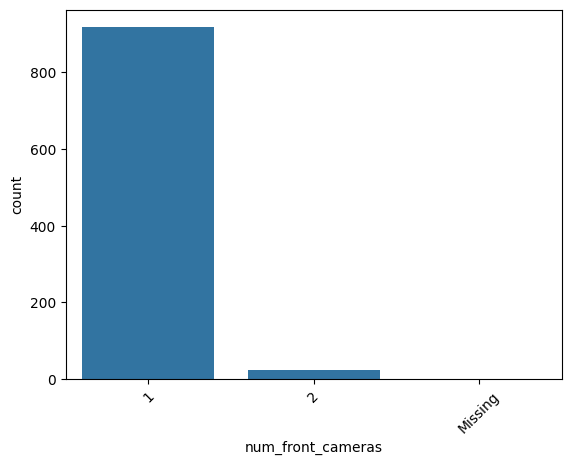

In [55]:
categorical_analysis(dataframe=final_df, column_name="num_front_cameras")

### Observations - num_front_cameras

- There are only two distinct values. Can be changed to categorical column(ordinal).

## num_rear_cameras

In [56]:
numerical_analysis(final_df, "num_rear_cameras", bins=10)

In [57]:
categorical_analysis(dataframe=final_df, column_name="num_rear_cameras")

,Count,Percentage
num_rear_cameras,,
3,529,56.16%
2,201,21.34%
4,150,15.92%
1,62,6.58%


**************************************************
The unique categories in num_rear_cameras column are [3, 2, 4, 1]
**************************************************
The number of categories in num_rear_cameras column are 4


### Observations - num_rear_cameras

- There are only four distinct values. Can be changed to categorical column(ordinal).

## primary_camera_rear

In [53]:
final_df.primary_camera_rear.dtype

dtype('O')

In [54]:
categorical_analysis(dataframe=final_df, column_name="primary_camera_rear")

,Count,Percentage
primary_camera_rear,,
50,319,33.86%
64,176,18.68%
13,115,12.21%
48,112,11.89%
108,77,8.17%
12,46,4.88%
8,39,4.14%
200,18,1.91%
16,16,1.7%


**************************************************
The unique categories in primary_camera_rear column are ['50', '64', '108', '12', '200', '13', '48', '8', '50.3', '12.2', '5', '54', '16', '2', '20', '47.2', '24']
**************************************************
The number of categories in primary_camera_rear column are 17


### Observations - primary_camera_rear

- There are only 13 distinct values.Can be changed to categorical column(ordinal).

## primary_camera_front

In [58]:
numerical_analysis(final_df, "primary_camera_front", bins=10)

In [59]:
categorical_analysis(dataframe=final_df, column_name="primary_camera_front")

,Count,Percentage
primary_camera_front,,
16.0,301,31.99%
8.0,177,18.81%
32.0,148,15.73%
5.0,119,12.65%
12.0,41,4.36%
13.0,40,4.25%
20.0,34,3.61%
10.0,21,2.23%
50.0,12,1.28%


**************************************************
The unique categories in primary_camera_front column are [16.0, 13.0, 8.0, 12.0, 32.0, 5.0, 50.0, 40.0, 10.0, 60.0, 2.0, 7.0, 10.8, 44.0, 20.0, 11.1, 48.0, 0.3, 24.0, 25.0, 10.1, 12.6, nan]
**************************************************
The number of categories in primary_camera_front column are 22


### Observations - primary_camera_front

- There are only 18 distinct values.Can be changed to categorical column(ordinal).

## extended_upto

In [60]:
numerical_analysis(final_df, "extended_upto", bins=10)

,Count,Percentage
extended_upto,,
0.0,329,39.83%
1024.0,263,31.84%
512.0,116,14.04%
256.0,98,11.86%
128.0,9,1.09%
2048.0,5,0.61%
32.0,3,0.36%
64.0,3,0.36%


**************************************************
The unique categories in extended_upto column are [0.0, 1024.0, nan, 512.0, 256.0, 2048.0, 128.0, 32.0, 64.0]
**************************************************
The number of categories in extended_upto column are 8


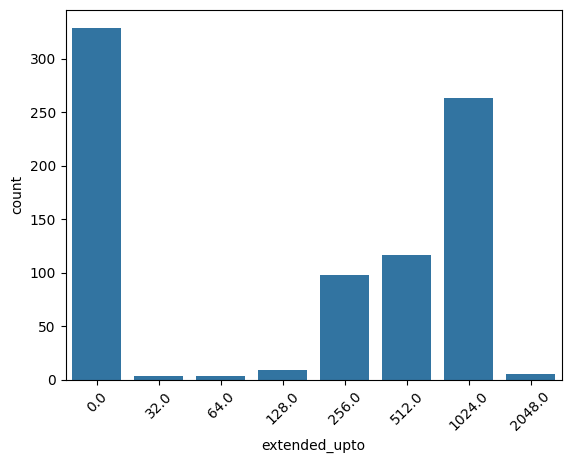

In [61]:
categorical_analysis(dataframe=final_df, column_name="extended_upto")

### Observations - extended_upto

- There are only seven distinct values.Can be changed to categorical column(ordinal).

In [62]:
final_df.screen_size.nunique()

67

### Observations - Numerical columns

`Change to categorical` : extended_upto, primary_camera_front, primary_camera_rear, num_rear_cameras, num_front_cameras, refresh_rate, ram_capacity, num_cores, internal_memory, fast_charging.

`Outliers` : screen size >= 7, battery_capacity > 7000



In [42]:
change_to_categorical = [
    "extended_upto", "primary_camera_front", "primary_camera_rear", 
    "num_rear_cameras", "num_front_cameras", "refresh_rate", 
    "ram_capacity", "num_cores", "extended_upto", "internal_memory",
    "fast_charging", "fast_charging_available", "extended_memory_available"
]

# Convert columns to categorical using assign
final_df = final_df.assign(**{col: final_df[col].astype('object') for col in change_to_categorical})

In [43]:
final_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 816 entries, 0 to 978
Data columns (total 25 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   model                      816 non-null    object 
 1   price                      816 non-null    int64  
 2   rating                     816 non-null    float64
 3   os                         816 non-null    object 
 4   brand_name                 816 non-null    object 
 5   has_5g                     816 non-null    bool   
 6   has_nfc                    816 non-null    bool   
 7   has_ir_blaster             816 non-null    bool   
 8   num_cores                  816 non-null    object 
 9   processor_speed            816 non-null    float64
 10  processor_brand            816 non-null    object 
 11  ram_capacity               816 non-null    object 
 12  internal_memory            816 non-null    object 
 13  battery_capacity           816 non-null    float64
 14 

In [44]:
cat_cols = final_df.select_dtypes(include=['object', 'bool']).columns.tolist()
cat_cols = [col for col in cat_cols if col != 'model']

num_cols = [col for col in final_df.columns.tolist() if col not in cat_cols and col not in ["rating", "model"]]


In [18]:
cat_cols

['os',
 'brand_name',
 'has_5g',
 'has_nfc',
 'has_ir_blaster',
 'num_cores',
 'processor_brand',
 'ram_capacity',
 'internal_memory',
 'fast_charging',
 'resolution',
 'refresh_rate',
 'num_rear_cameras',
 'num_front_cameras',
 'primary_camera_rear',
 'primary_camera_front',
 'fast_charging_available',
 'extended_memory_available',
 'extended_upto']

In [19]:
num_cols

['price', 'processor_speed', 'battery_capacity', 'screen_size']

## Categorical columns

In [68]:
final_df["model"].value_counts()

model
Samsung Galaxy M52s 5G         1
OnePlus 11 5G                  1
OnePlus Nord CE 2 Lite 5G      1
Samsung Galaxy A14 5G          1
Motorola Moto G62 5G           1
                              ..
OnePlus 10R 5G                 1
OPPO Reno 9 Pro Plus           1
Vivo Y16                       1
Apple iPhone 13                1
Samsung Galaxy S23 Ultra 5G    1
Name: count, Length: 942, dtype: int64

### Observations - model

- Drop model column

,Count,Percentage
brand_name,,
xiaomi,130,13.8%
samsung,129,13.69%
vivo,106,11.25%
realme,97,10.3%
oppo,84,8.92%
motorola,52,5.52%
oneplus,42,4.46%
poco,41,4.35%
apple,35,3.72%


**************************************************
The unique categories in brand_name column are ['oneplus', 'samsung', 'motorola', 'realme', 'apple', 'xiaomi', 'nothing', 'oppo', 'vivo', 'poco', 'iqoo', 'jio', 'gionee', 'tecno', 'tesla', 'google', 'infinix', 'cola', 'letv', 'ikall', 'leeco', 'duoqin', 'nokia', 'lava', 'honor', 'nubia', 'redmi', 'asus', 'itel', 'sony', 'blu', 'lyf', 'huawei', 'zte', 'lenovo', 'lg', 'micromax', 'leitz', 'cat', 'tcl', 'sharp', 'blackview', 'doogee']
**************************************************
The number of categories in brand_name column are 43


,Count,Percentage
has_5g,,
True,519,55.1%
False,423,44.9%


**************************************************
The unique categories in has_5g column are [True, False]
**************************************************
The number of categories in has_5g column are 2


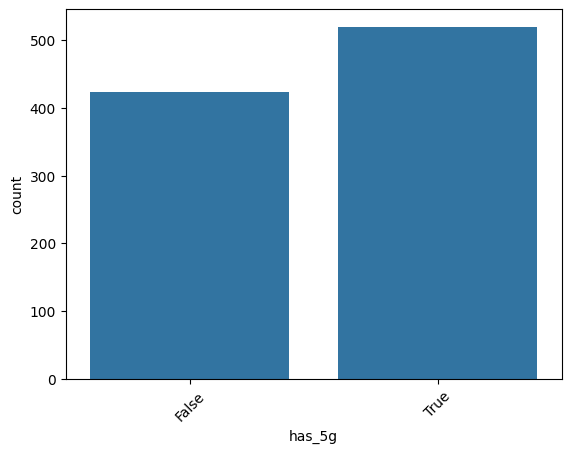

,Count,Percentage
has_nfc,,
False,581,61.68%
True,361,38.32%


**************************************************
The unique categories in has_nfc column are [True, False]
**************************************************
The number of categories in has_nfc column are 2


,Count,Percentage
has_ir_blaster,,
False,790,83.86%
True,152,16.14%


**************************************************
The unique categories in has_ir_blaster column are [False, True]
**************************************************
The number of categories in has_ir_blaster column are 2


,Count,Percentage
num_cores,,
8.0,872,93.06%
4.0,36,3.84%
6.0,29,3.09%


**************************************************
The unique categories in num_cores column are [8.0, 6.0, 4.0, nan]
**************************************************
The number of categories in num_cores column are 3


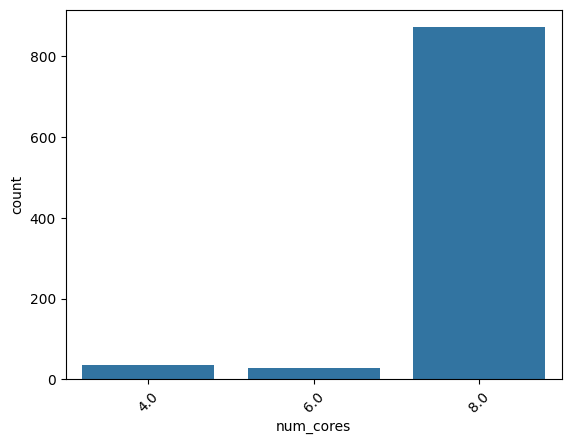

,Count,Percentage
processor_brand,,
snapdragon,392,42.52%
helio,198,21.48%
dimensity,176,19.09%
exynos,50,5.42%
bionic,34,3.69%
unisoc,26,2.82%
tiger,24,2.6%
google,9,0.98%
kirin,5,0.54%


**************************************************
The unique categories in processor_brand column are ['snapdragon', 'exynos', 'dimensity', 'bionic', 'helio', 'unisoc', 'tiger', nan, 'google', 'sc9863a', 'spreadtrum', 'fusion', 'kirin', '(28']
**************************************************
The number of categories in processor_brand column are 13


,Count,Percentage
ram_capacity,,
8.0,329,34.93%
6.0,231,24.52%
4.0,209,22.19%
12.0,70,7.43%
3.0,54,5.73%
2.0,31,3.29%
16.0,9,0.96%
1.0,7,0.74%
18.0,2,0.21%


**************************************************
The unique categories in ram_capacity column are [12.0, 6.0, 4.0, 8.0, 3.0, 16.0, 2.0, 18.0, 1.0]
**************************************************
The number of categories in ram_capacity column are 9


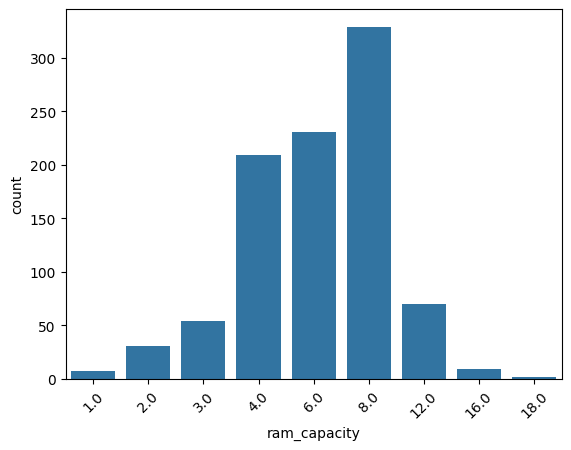

,Count,Percentage
internal_memory,,
128.0,517,54.88%
64.0,188,19.96%
256.0,139,14.76%
32.0,67,7.11%
512.0,14,1.49%
16.0,12,1.27%
1024.0,4,0.42%
8.0,1,0.11%


**************************************************
The unique categories in internal_memory column are [256.0, 128.0, 64.0, 32.0, 512.0, 1024.0, 16.0, 8.0]
**************************************************
The number of categories in internal_memory column are 8


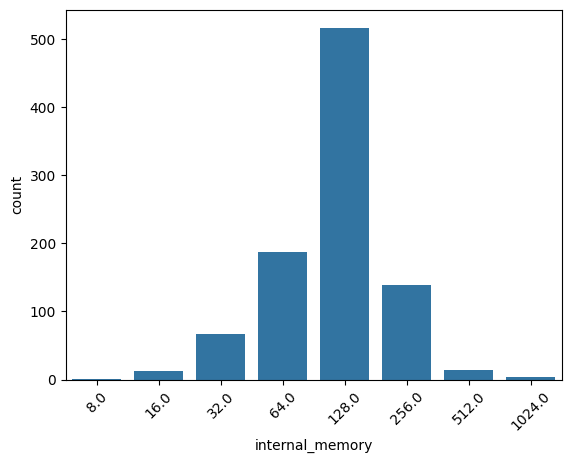

,Count,Percentage
fast_charging,,
33.0,149,19.95%
18.0,128,17.14%
67.0,61,8.17%
25.0,50,6.69%
120.0,46,6.16%
15.0,43,5.76%
80.0,40,5.35%
10.0,33,4.42%
30.0,32,4.28%


**************************************************
The unique categories in fast_charging column are [100.0, 33.0, 15.0, nan, 67.0, 25.0, 120.0, 80.0, 18.0, 45.0, 10.0, 66.0, 44.0, 210.0, 30.0, 150.0, 68.0, 50.0, 20.0, 65.0, 180.0, 125.0, 40.0, 60.0, 200.0, 240.0, 19.0, 21.0, 135.0, 165.0, 22.0, 55.0]
**************************************************
The number of categories in fast_charging column are 31


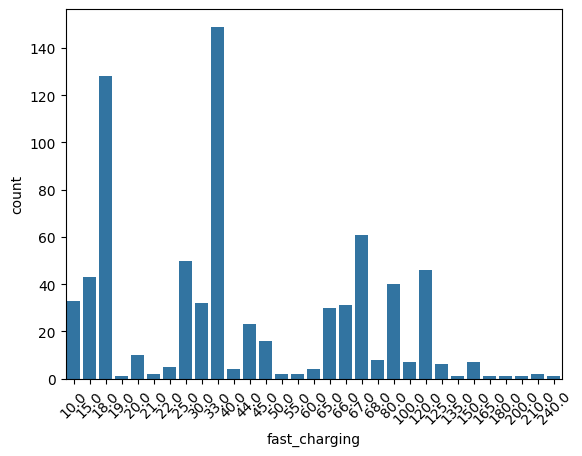

,Count,Percentage
resolution,,
1080 x 2400,340,36.09%
720 x 1600,149,15.82%
1080 x 2408,64,6.79%
1080 x 2412,58,6.16%
1080 x 2340,39,4.14%
...,...,...
480 x 640,1,0.11%
720 x 1480,1,0.11%
1440 x 3168,1,0.11%


**************************************************
The unique categories in resolution column are ['1440\u2009x\u20093216\u2009', '1080\u2009x\u20092412\u2009', '1080\u2009x\u20092408\u2009', '1080\u2009x\u20092400\u2009', '1170\u2009x\u20092532\u2009', '720\u2009x\u20091612\u2009', '1440\u2009x\u20093088\u2009', '720\u2009x\u20091600\u2009', '1080\u2009x\u20092376\u2009', '1290\u2009x\u20092796\u2009', '828\u2009x\u20091792\u2009', '1080\u2009x\u20092340\u2009', '1440\u2009x\u20093080\u2009', '1080\u2009x\u20092460\u2009', '1284\u2009x\u20092778\u2009', '1440\u2009x\u20093200\u2009', '1179\u2009x\u20092556\u2009', '1080\u2009x\u20092404\u2009', '1080\u2009x\u20092448\u2009', '720\u2009x\u20091280\u2009', '720\u2009x\u20091560\u2009', '2460\u2009x\u20091080\u2009', '1260\u2009x\u20092800\u2009', '2408\u2009x\u20091080\u2009', '750\u2009x\u20091334\u2009', '640\u2009x\u2009960\u2009', '1400\u2009x\u20093200\u2009', '1600\u2009x\u2009720\u2009', '1440\u2009x\u20093120\u2009', '720\u2009x

,Count,Percentage
refresh_rate,,
60,348,36.94%
120,327,34.71%
90,218,23.14%
144,39,4.14%
165,9,0.96%
240,1,0.11%


**************************************************
The unique categories in refresh_rate column are [120, 90, 60, 144, 165, 240]
**************************************************
The number of categories in refresh_rate column are 6


,Count,Percentage
num_rear_cameras,,
3,529,56.16%
2,201,21.34%
4,150,15.92%
1,62,6.58%


**************************************************
The unique categories in num_rear_cameras column are [3, 2, 4, 1]
**************************************************
The number of categories in num_rear_cameras column are 4


,Count,Percentage
num_front_cameras,,
1,918,97.45%
2,23,2.44%
Missing,1,0.11%


**************************************************
The unique categories in num_front_cameras column are ['1', '2', 'Missing']
**************************************************
The number of categories in num_front_cameras column are 3


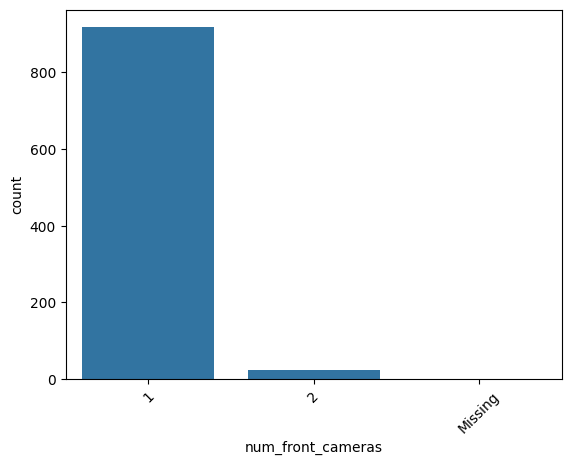

,Count,Percentage
primary_camera_rear,,
50,319,33.86%
64,176,18.68%
13,115,12.21%
48,112,11.89%
108,77,8.17%
12,46,4.88%
8,39,4.14%
200,18,1.91%
16,16,1.7%


**************************************************
The unique categories in primary_camera_rear column are ['50', '64', '108', '12', '200', '13', '48', '8', '50.3', '12.2', '5', '54', '16', '2', '20', '47.2', '24']
**************************************************
The number of categories in primary_camera_rear column are 17


,Count,Percentage
primary_camera_front,,
16.0,301,31.99%
8.0,177,18.81%
32.0,148,15.73%
5.0,119,12.65%
12.0,41,4.36%
13.0,40,4.25%
20.0,34,3.61%
10.0,21,2.23%
50.0,12,1.28%


**************************************************
The unique categories in primary_camera_front column are [16.0, 13.0, 8.0, 12.0, 32.0, 5.0, 50.0, 40.0, 10.0, 60.0, 2.0, 7.0, 10.8, 44.0, 20.0, 11.1, 48.0, 0.3, 24.0, 25.0, 10.1, 12.6, nan]
**************************************************
The number of categories in primary_camera_front column are 22


,Count,Percentage
fast_charging_available,,
1,814,86.41%
0,128,13.59%


**************************************************
The unique categories in fast_charging_available column are [1, 0]
**************************************************
The number of categories in fast_charging_available column are 2


,Count,Percentage
extended_memory_available,,
1,613,65.07%
0,329,34.93%


**************************************************
The unique categories in extended_memory_available column are [0, 1]
**************************************************
The number of categories in extended_memory_available column are 2


,Count,Percentage
extended_upto,,
0.0,329,39.83%
1024.0,263,31.84%
512.0,116,14.04%
256.0,98,11.86%
128.0,9,1.09%
2048.0,5,0.61%
32.0,3,0.36%
64.0,3,0.36%


**************************************************
The unique categories in extended_upto column are [0.0, 1024.0, nan, 512.0, 256.0, 2048.0, 128.0, 32.0, 64.0]
**************************************************
The number of categories in extended_upto column are 8


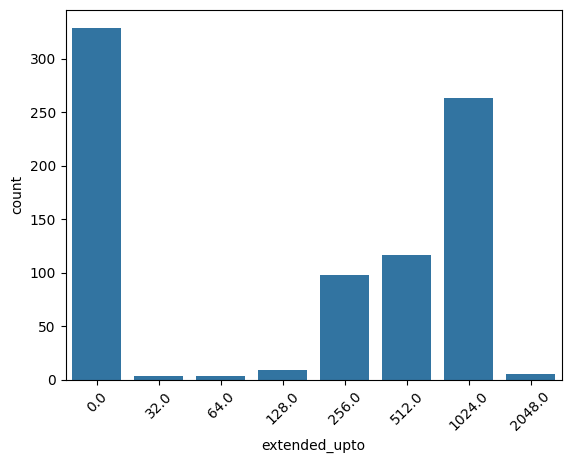

In [69]:
for col in cat_cols[1:]:
    categorical_analysis(dataframe=final_df, column_name=col)

### Observations - Categorical Columns

#### **High Cardinality Categories**
- **brand_name**: 37 unique values (nominal)
- **processor_brand**: 11 unique values (nominal) 
- **ram_capacity**: 8 unique values (ordinal) 
- **fast_charging**: 35 unique values  (ordinal) 
- **resolution**: 50 unique values  (ordinal) 
- **primary_camera_rear**: 13 unique values  (ordinal) 
- **primary_camera_front**: 17 unique values (ordinal)  
- **extended_upto**: : 8 unique values (ordinal)  

In [25]:
high_cardinality = {}
for col in cat_cols:
    unique_categories = final_df[col].nunique()
    if unique_categories > 7:
        high_cardinality[col] = unique_categories

In [26]:
high_cardinality

{'brand_name': 43,
 'processor_brand': 13,
 'ram_capacity': 9,
 'internal_memory': 8,
 'fast_charging': 31,
 'resolution': 71,
 'primary_camera_rear': 17,
 'primary_camera_front': 22,
 'extended_upto': 8}

In [27]:
num_rows = int(len(high_cardinality) / 2) + (len(high_cardinality) % 2)
fig, axes = plt.subplots(nrows=num_rows, ncols=2, figsize=(18, 15))
axes = axes.flatten()

for i, col in enumerate(high_cardinality):
    if i < len(axes):
        sns.countplot(y=final_df[col], hue=final_df[col], order=final_df[col].value_counts().index, palette="viridis", ax=axes[i], legend=False)
        axes[i].set_title(f"Distribution of {col}")
        axes[i].set_xlabel("Count")
        axes[i].set_ylabel(col)
        axes[i].grid(True, linestyle='--', alpha=0.7)

        # Rotate y-axis labels
        axes[i].tick_params(axis='y', rotation=5) 

    else:
        break

for i in range(len(high_cardinality), len(axes)):
    axes[i].axis('off')

plt.tight_layout()
plt.show()

### resolution

In [48]:
final_df.assign(
    resolution_category=lambda x: np.select(
        [
            x["resolution"].str.extract(r"(\d+)").astype(float) < 1080,
            (x["resolution"].str.extract(r"(\d+)").astype(float) >= 1080) & 
            (x["resolution"].str.extract(r"(\d+)").astype(float) < 1440),
            (x["resolution"].str.extract(r"(\d+)").astype(float) >= 1440) & 
            (x["resolution"].str.extract(r"(\d+)").astype(float) < 2160),
            x["resolution"].str.extract(r"(\d+)").astype(float) >= 2160,
        ],
        ["HD Ready", "Full HD", "Quad HD", "Ultra HD"],
        default="Unknown"
    )
)["resolution_category"].value_counts()

resolution_category
Full HD     577
HD Ready    180
Quad HD      44
Ultra HD     15
Name: count, dtype: int64

### brand_name

In [87]:
b_ds = final_df.assign(
    brand_name=lambda x: x["brand_name"].mask(
        x["brand_name"].map(x["brand_name"].value_counts()) < 10, "other"
    )
)

In [88]:
numerical_categorical_analysis(dataframe=b_ds, cat_column_1= "brand_name", num_column="rating")

### ram_capacity

In [70]:
r_ds = final_df.assign(
    ram_category=np.select(
        [
            final_df["ram_capacity"].astype(float) <= 4, 
            final_df["ram_capacity"].astype(float) <= 8
        ],
        ["Low", "Standard"],
        default="High"
    )
)

In [71]:
numerical_categorical_analysis(dataframe=r_ds, cat_column_1= "ram_capacity", num_column="rating")

### processor_brand

In [67]:
p_ds = final_df.assign(
    processor_brand=lambda x: x["processor_brand"].mask(
        x["processor_brand"].map(x["processor_brand"].value_counts()) < 5, "other"
    )
)

In [69]:
numerical_categorical_analysis(dataframe=p_ds, cat_column_1= "processor_brand", num_column="rating")

### fast_charging

In [58]:
categorical_analysis(dataframe=final_df, column_name="fast_charging")

,Count,Percentage
fast_charging,,
33.0,151,18.5%
18.0,129,15.81%
0.0,93,11.4%
67.0,56,6.86%
15.0,51,6.25%
25.0,43,5.27%
120.0,36,4.41%
80.0,35,4.29%
30.0,31,3.8%


**************************************************
The unique categories in fast_charging column are [100.0, 33.0, 15.0, 30.0, 67.0, 25.0, 9.0, 120.0, 80.0, 18.0, 10.0, 66.0, 44.0, 0.0, 210.0, 45.0, 150.0, 68.0, 50.0, 20.0, 65.0, 180.0, 125.0, 40.0, 60.0, 200.0, 24.0, 240.0, 19.0, 25.5, 21.0, 135.0, 165.0, 22.0, 55.0]
**************************************************
The number of categories in fast_charging column are 35


In [64]:
f_ds = final_df.assign(
    fast_charging=np.select(
        [
            final_df["fast_charging"] == 0.0,
            (final_df["fast_charging"] > 0.0) & (final_df["fast_charging"] <= 18),
            (final_df["fast_charging"] > 18) & (final_df["fast_charging"] <= 33),
            (final_df["fast_charging"] > 33) & (final_df["fast_charging"] <= 65),
            (final_df["fast_charging"] > 65) & (final_df["fast_charging"] <= 120)
        ],
        ["no", "basic", "moderate", "fast", "ultra fast"],
        default="extreme fast"
    )
)

In [65]:
numerical_categorical_analysis(dataframe=f_ds, cat_column_1= "fast_charging", num_column="rating")

### primary_camera_rear

,Count,Percentage
primary_camera_rear,,
50,291,35.66%
64,167,20.47%
13,103,12.62%
48,98,12.01%
108,64,7.84%
12,40,4.9%
8,19,2.33%
16,16,1.96%
200,8,0.98%


**************************************************
The unique categories in primary_camera_rear column are ['50', '64', '108', '12', '200', '13', '48', '8', '54', '16', '20', '12.2', '24']
**************************************************
The number of categories in primary_camera_rear column are 13


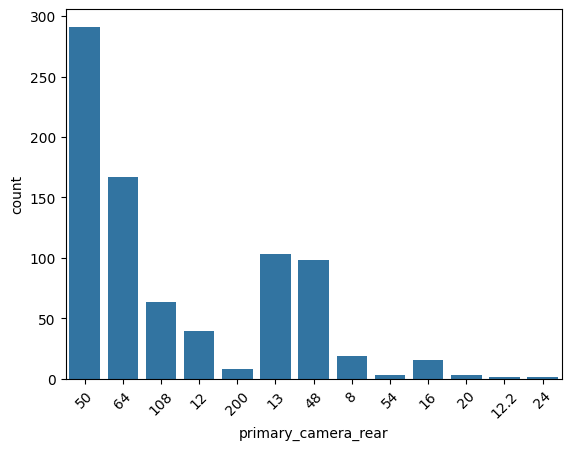

In [66]:
categorical_analysis(dataframe=final_df, column_name="primary_camera_rear")

In [73]:
pc_r_ds = final_df.assign(
    primary_camera_rear=np.select(
        [
            final_df["primary_camera_rear"].astype(float) <= 8,
            (final_df["primary_camera_rear"].astype(float) > 8) & (final_df["primary_camera_rear"].astype(float) <= 16),
            (final_df["primary_camera_rear"].astype(float) > 16) & (final_df["primary_camera_rear"].astype(float) <= 48),
            (final_df["primary_camera_rear"].astype(float) > 48) & (final_df["primary_camera_rear"].astype(float) <= 64),
            (final_df["primary_camera_rear"].astype(float) > 64) & (final_df["primary_camera_rear"].astype(float) <= 108)
        ],
        ["basic", "standard", "good", "high-Resolution", "ultra-high"],
        default="extreme"
    )
)

In [74]:
numerical_categorical_analysis(dataframe=pc_r_ds, cat_column_1= "primary_camera_rear", num_column="rating")

### primary_camera_front

In [75]:
categorical_analysis(dataframe=final_df, column_name="primary_camera_front")

,Count,Percentage
primary_camera_front,,
16.0,295,36.15%
8.0,165,20.22%
32.0,116,14.22%
5.0,93,11.4%
13.0,34,4.17%
20.0,33,4.04%
12.0,26,3.19%
10.0,18,2.21%
50.0,11,1.35%


**************************************************
The unique categories in primary_camera_front column are [16.0, 13.0, 8.0, 12.0, 32.0, 5.0, 50.0, 10.0, 60.0, 7.0, 44.0, 10.8, 20.0, 11.1, 48.0, 24.0, 25.0]
**************************************************
The number of categories in primary_camera_front column are 17


In [77]:
pc_r_ds = final_df.assign(
    primary_camera_front=np.select(
        [
            final_df["primary_camera_front"].astype(float) <= 8,
            (final_df["primary_camera_front"].astype(float) > 8) & (final_df["primary_camera_front"].astype(float) <= 16),
            (final_df["primary_camera_front"].astype(float) > 16) & (final_df["primary_camera_front"].astype(float) <= 32),
            (final_df["primary_camera_front"].astype(float) > 32) & (final_df["primary_camera_front"].astype(float) <= 48)
        ],
        ["basic", "standard", "good", "high-resolution"],
        default="ultra high"
    )
)

In [78]:
numerical_categorical_analysis(dataframe=pc_r_ds, cat_column_1= "primary_camera_front", num_column="rating")

### extended_upto

In [17]:
categorical_analysis(dataframe=final_df, column_name="extended_upto")

,Count,Percentage
extended_upto,,
1024.0,337,41.3%
0.0,267,32.72%
512.0,110,13.48%
256.0,90,11.03%
2048.0,5,0.61%
128.0,5,0.61%
64.0,2,0.25%


**************************************************
The unique categories in extended_upto column are [0.0, 1024.0, 512.0, 256.0, 2048.0, 128.0, 64.0]
**************************************************
The number of categories in extended_upto column are 7


In [20]:
ex_ds = final_df.assign(
    extended_upto=np.select(
        [
            final_df["extended_upto"] == 0.0,  # No expansion
            final_df["extended_upto"].isin([64.0, 128.0, 256.0]),  # Small expansion
            final_df["extended_upto"] == 512.0,  # Medium expansion
            final_df["extended_upto"] == 1024.0,  # Large expansion
            final_df["extended_upto"] == 2048.0  # Very large expansion
        ],
        ["no expansion", "small", "medium", "large", "very large"],
        default="unknown"
    )
)

In [22]:
numerical_categorical_analysis(dataframe=ex_ds, cat_column_1= "extended_upto", num_column="rating")

# Bivariate Ananlysis

### Numerical Columns

In [73]:
# relationship between target and all numerical columns
for col in num_cols:
    sns.scatterplot(data=final_df, x=col, y='rating')
    plt.show()

### Observations 

- processor_speed, battery_capacity are correlated with the rating column.

### Categorical Columns

In [74]:
cat_cols

['os',
 'brand_name',
 'has_5g',
 'has_nfc',
 'has_ir_blaster',
 'num_cores',
 'processor_brand',
 'ram_capacity',
 'internal_memory',
 'fast_charging',
 'resolution',
 'refresh_rate',
 'num_rear_cameras',
 'num_front_cameras',
 'primary_camera_rear',
 'primary_camera_front',
 'fast_charging_available',
 'extended_memory_available',
 'extended_upto']

In [75]:
# relationship between target and all categorical columns
for col in cat_cols:
    print("\n")
    print(f"--------------------------------------------{col}----------------------------------------------------------------------------------")
    print("\n")
    unique_categories = final_df[col].nunique()
    numerical_categorical_analysis(final_df, col, 'rating')
    if unique_categories >= 3:
        anova_test(final_df, "rating", col)
    else:
        two_sample_independent_ttest(final_df, "rating", col)
    



--------------------------------------------os----------------------------------------------------------------------------------




ANOVA p-value: 0.6691538026380597
Fail to reject the null hypothesis. There is no significant relationship between rating and os.


--------------------------------------------brand_name----------------------------------------------------------------------------------




ANOVA p-value: 3.036102031778386e-15
Reject the null hypothesis. There is a significant relationship between rating and brand_name.


--------------------------------------------has_5g----------------------------------------------------------------------------------




T-statistic: 21.8364, p-value: 0.0000
Reject the null hypothesis. The means of rating differ between the two categories of has_5g.


--------------------------------------------has_nfc----------------------------------------------------------------------------------




T-statistic: 18.3314, p-value: 0.0000
Reject the null hypothesis. The means of rating differ between the two categories of has_nfc.


--------------------------------------------has_ir_blaster----------------------------------------------------------------------------------




T-statistic: -6.3349, p-value: 0.0000
Reject the null hypothesis. The means of rating differ between the two categories of has_ir_blaster.


--------------------------------------------num_cores----------------------------------------------------------------------------------




ANOVA p-value: 4.981249432946442e-13
Reject the null hypothesis. There is a significant relationship between rating and num_cores.


--------------------------------------------processor_brand----------------------------------------------------------------------------------




ANOVA p-value: 6.242798846268413e-85
Reject the null hypothesis. There is a significant relationship between rating and processor_brand.


--------------------------------------------ram_capacity----------------------------------------------------------------------------------




ANOVA p-value: 3.944589018857888e-235
Reject the null hypothesis. There is a significant relationship between rating and ram_capacity.


--------------------------------------------internal_memory----------------------------------------------------------------------------------




ANOVA p-value: 2.2167423915224386e-173
Reject the null hypothesis. There is a significant relationship between rating and internal_memory.


--------------------------------------------fast_charging----------------------------------------------------------------------------------




ANOVA p-value: 1.0058220956745352e-114
Reject the null hypothesis. There is a significant relationship between rating and fast_charging.


--------------------------------------------resolution----------------------------------------------------------------------------------




ANOVA p-value: 7.35164840717488e-164
Reject the null hypothesis. There is a significant relationship between rating and resolution.


--------------------------------------------refresh_rate----------------------------------------------------------------------------------




ANOVA p-value: 3.024409040453866e-90
Reject the null hypothesis. There is a significant relationship between rating and refresh_rate.


--------------------------------------------num_rear_cameras----------------------------------------------------------------------------------




ANOVA p-value: 1.9282091548681224e-76
Reject the null hypothesis. There is a significant relationship between rating and num_rear_cameras.


--------------------------------------------num_front_cameras----------------------------------------------------------------------------------




ANOVA p-value: 0.00022012512783660857
Reject the null hypothesis. There is a significant relationship between rating and num_front_cameras.


--------------------------------------------primary_camera_rear----------------------------------------------------------------------------------




ANOVA p-value: 1.18326510027522e-151
Reject the null hypothesis. There is a significant relationship between rating and primary_camera_rear.


--------------------------------------------primary_camera_front----------------------------------------------------------------------------------




ANOVA p-value: 3.159641423182491e-167
Reject the null hypothesis. There is a significant relationship between rating and primary_camera_front.


--------------------------------------------fast_charging_available----------------------------------------------------------------------------------




T-statistic: 26.0363, p-value: 0.0000
Reject the null hypothesis. The means of rating differ between the two categories of fast_charging_available.


--------------------------------------------extended_memory_available----------------------------------------------------------------------------------




T-statistic: 15.2521, p-value: 0.0000
Reject the null hypothesis. The means of rating differ between the two categories of extended_memory_available.


--------------------------------------------extended_upto----------------------------------------------------------------------------------




ANOVA p-value: 2.078716460165893e-53
Reject the null hypothesis. There is a significant relationship between rating and extended_upto.


### Observations 

- Not associated - os

# Multivariate Ananlysis

In [89]:
multi_ds = final_df.assign(
    brand_name=lambda x: x["brand_name"].mask(
        x["brand_name"].map(x["brand_name"].value_counts()) < 10, "other"
    ),
    processor_brand=lambda x: x["processor_brand"].mask(
        x["processor_brand"].map(x["processor_brand"].value_counts()) < 5, "other"
    )
)

In [90]:
# How does brand_name interact with processor_brand to affect rating?
multivariate_analysis(dataframe=multi_ds, num_column="rating", cat_column_1="brand_name", cat_column_2="processor_brand")


In [91]:
multi_ds.brand_name.value_counts(normalize = True)

brand_name
xiaomi      0.151961
samsung     0.125000
vivo        0.115196
realme      0.112745
oppo        0.099265
other       0.094363
motorola    0.058824
poco        0.047794
oneplus     0.045343
iqoo        0.037990
tecno       0.037990
infinix     0.034314
apple       0.025735
honor       0.013480
Name: proportion, dtype: float64

## Automated EDA using ydata-profiling

In [76]:
# Generate the profile report
profile = ProfileReport(analysis_df, explorative=True)

# Display the report in a Jupyter Notebook
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [78]:
# Save report to an HTML file
profile.to_file("../../reports/eda_report.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]